# **Adaptive Edge: Short-Term Precision**
### **Team:** SiddAdi
### **By:** Siddharth Acharya
### **College:** IIT Madras

# **Introduction**

Operating on a dynamic 3-minute timeframe, Adaptive Edge pioneers precision in short-term trading. With a keen eye on market anomalies, it not only navigates fluctuations strategically but also boasts remarkable gains, showcasing a winning formula for high-performance trading.

# **Important Considerations**
- All trades occur on 3 minute closing.
- As per the contest rules:
    - Every trade involves a fixed quantity of 100 contracts.
    - A standard commission of 750 is applied for each trade.
    - No complex strategies like position sizing, multiple trades, or averaging are employed.

# **Import Packages**

We begin by importing the necessary packages for data processing and visualizing the results and plots.

In [1]:
import pandas as pd
import pandas_ta as ta
import numpy as np

import plotly.graph_objects as go
from plotly.subplots import make_subplots
from datetime import datetime

# **Load Dataset**
The provided dataset is loaded. If using this code version, ensure to modify the `csv_path` to the correct file path after downloading the dataset. The dataset is described as a 1-minute OHLC dataset, including information such as Date, Expiry Date of the contract, and Time. Appropriate header files are added for clarity as shown below.

In [2]:
csv_path = "/Users/siddharthacharya/Downloads/Data_2020-2022_wExpiry.csv"
columns = ['Date', 'ExpiryDate', 'Time', 'Open', 'High', 'Low', 'Close']
df_1 = pd.read_csv(csv_path, header=None, names=columns)
df_1 = df_1.dropna()
df_1.tail()

,Date,ExpiryDate,Time,Open,High,Low,Close
277870,20221230,20230125,1526,23110.54002,23144.45146,23108.56403,23135.66988
277871,20221230,20230125,1527,23133.20795,23134.09097,23110.70025,23111.47473
277872,20221230,20230125,1528,23111.82193,23121.38728,23104.82660,23121.38728
277873,20221230,20230125,1529,23118.95512,23134.30505,23111.82193,23122.91099
277874,20221230,20230125,1530,23122.45653,23132.08420,23120.63887,23130.66629


Our trading strategy relies on 3 minute closing prices to make decisions and find the winnning patterns. To make our model work, we first have to change the given 1-minute data into the 3 minute timeframe format. This was already discussed in the previous strategy. Here's how we do it:

In [3]:
# Preserve the original dataset
dfc = df_1.copy()

# Convert 'Date' column to a datetime format
dfc['Date'] = pd.to_datetime(dfc['Date'], format='%Y%m%d')

# Extract hour and minute information from the 'Time' column
dfc['Hour'] = dfc['Time'] // 100
dfc['Minute'] = dfc['Time'] % 100

# Create a new datetime column combining date, hour, and minute
dfc['DateTime'] = pd.to_datetime(dfc[['Date', 'Hour', 'Minute']].astype(str).agg('-'.join, axis=1), format='%Y-%m-%d-%H-%M')

# Set 'DateTime' column as the index
dfc.set_index('DateTime', inplace=True)

In [4]:
def df_tf(t):
    # Resample the data to desired intervals and use the open price as the resampling method
    df_tf = dfc.resample(f'{t}',closed = 'right').agg({'Open': 'first', 'High': 'max', 'Low': 'min', 'Close': 'last'})

    df_tf.dropna(subset=['Close'], inplace=True)

    # Reset the index to make 'DateTime' a regular column again
    df_tf.reset_index(inplace=True)
    return df_tf

# **Psuedocode: High Level Strategy Logic**

## Requirements:
- A signal (Up, Down, or None) derived from the change in the 2 previous bars.
- Utilization of the 3-Minute MACD Indicator for Buy and Sell signals.
- Monitoring consecutive 'up' and 'down' movements from the combination of MACD and 2-bar return.
- Adherence to specific intraday trading timings.
- Implementation of effective position management.
  
## Signal Generation & Trade Execution:
- Key logic revolves around exploiting price reversion after continuous market movements.
- Track consecutive 'up' movements in the 2-bar signal in the absence of a buy signal from MACD, increasing the likelihood of a reversal.
- Similarly, monitor consecutive 'down' movements in the absence of a sell signal from MACD.
- Execute a reverse trade when there are fewer than 3 consecutive up or down movements, provided the movement lacks MACD support, indicating a potential short-term reversal.
- Close positions based on trade PNL or consecutive movements, currently 4 movements, favoring the current direction, signifying captured momentum.
  
## Risk Management:
- Maintain a fixed Stop Loss (SL) at 15,000, adjustable based on the user's risk tolerance.
- Balancing trade opportunities with SL adjustments:
    - Decreasing SL increases trade frequency but reduces the win rate.
  
## Position Management:
- No simultaneous open positions.
- Close all positions at 3:00 PM each day.

# **Two-Bar Return**

In this section, the focus is on calculating the change in the closing price from two candles ago. This is achieved by creating a new column:`2_Candle_Signal`. The `2_Candle_Signal` column, captures whether the difference in closing prices from two candles ago is greater than 10 points.

The choice of 10 points as a threshold is strategic. In this context, it is essential to consider the trading scenario. With a quantity of 100, the minimum price difference required to cover a commission of 750 is 7.5 points. To simplify, a threshold of 10 points is chosen, creating three distinct bins: below -10, above 10, and in between. The `2_Candle_Signal` thus provides a signal for each candle, indicating whether the price difference from two candles ago was greater than 10 points, less than -10 points, or within the -10 to 10 point range. This strategic binning facilitates decision-making, helping to identify significant price movements and potential profit opportunities.

In [5]:
df_3T = df_tf('3T')
df = df_3T.copy() 

# Trades taken at closing price
df_3T['DateTime'] = df['DateTime'] + pd.Timedelta(minutes=3)

df_3T['1_Candle_Change'] = df_3T['Close'] - df_3T['Close'].shift(1)
df_3T['2_Candle_Change'] = df_3T['Close'] - df_3T['Close'].shift(2)


# Classify the change based on the threshold
df_3T['1_Candle_Signal'] = pd.cut(df_3T['1_Candle_Change'], bins=[-float('inf'), -10, 10, float('inf')],
                               labels=['Down', 'None', 'Up'])
df_3T['2_Candle_Signal'] = pd.cut(df_3T['2_Candle_Change'], bins=[-float('inf'), -10, 10, float('inf')],
                               labels=['Down', 'None', 'Up'])

df_3T = df_3T.dropna()

# **Technical Indicators**

Almost all scalping stragies thrive on momentum. In our case we use the Moving Average Convergence Divergence (MACD) technical indicator to filter the bullish and bearish signals in the market.

In [6]:
# Calculate the MACD
def calculate_macd(df, fast_period=12, slow_period=26, signal_period=9):
    df['fast_ema'] = df['Close'].ewm(span=fast_period, min_periods=1, adjust=False).mean()
    df['slow_ema'] = df['Close'].ewm(span=slow_period, min_periods=1, adjust=False).mean()
    df['macd'] = df['fast_ema'] - df['slow_ema']
    df['signal_line'] = df['macd'].ewm(span=signal_period, min_periods=1, adjust=False).mean()
    df['macd_histogram'] = df['macd'] - df['signal_line']

calculate_macd(df_3T)
# Generate Buy and Sell signals based on your conditions
df_3T['buy_signal'] = (df_3T['macd'] > 0) & (df_3T['macd'].shift(1) <= 0) & (df_3T['macd'] > df_3T['signal_line'])
df_3T['sell_signal'] = (df_3T['macd'] < 0) & (df_3T['macd'].shift(1) >= 0) & (df_3T['macd'] < df_3T['signal_line'])

# **Backtester Class**

In [7]:
class Backtester:
    def __init__(self):
        # Initialize strategy parameters and variables
        self.long_position = {'active': False, 'entry_price': 0.0, 'exit_price': 0.0, 'trade_pnl': 0.0}
        self.short_position = {'active': False, 'entry_price': 0.0, 'exit_price': 0.0, 'trade_pnl': 0.0}
        self.current_pnl = 0.0  # Track current pnl for the active position
        self.pnl = 0.0
        self.total_pnl = []
        self.trades = []
    
    def execute_trade(self, trade_type, entry_price, entry_time):
        # Execute a trade and update relevant variables
        trade = {'type': trade_type, 'entry_price': entry_price, 'entry_time': entry_time,
                 'exit_price': None, 'exit_time': None, 'trade_pnl': 0.0}
        self.trades.append(trade)

        if trade_type == 'long':
            self.long_position['active'] = True
            self.long_position['entry_price'] = entry_price

        elif trade_type == 'short':
            self.short_position['active'] = True
            self.short_position['entry_price'] = entry_price

        else:
            trade_pnl = 0

        self.total_pnl.append(self.pnl)

    def close_position(self, exit_price,exit_time):
        # Close the active position and update relevant variables
        if self.long_position['active']:
            self.long_position['active'] = False
            self.long_position['exit_price'] = exit_price
            self.long_position['trade_pnl'] = 100 * (exit_price - self.long_position['entry_price']) - 750
            self.pnl += self.long_position['trade_pnl']
            self.current_pnl = 0.0  # Reset current pnl after exiting

            # Update exit price and pnl in the trades list
            self.trades[-1]['exit_price'] = exit_price
            self.trades[-1]['exit_time'] = exit_time
            self.trades[-1]['trade_pnl'] = self.long_position['trade_pnl']
            self.total_pnl.append(self.pnl)

        elif self.short_position['active']:
            self.short_position['active'] = False
            self.short_position['exit_price'] = exit_price
            self.short_position['trade_pnl'] = -100 * (exit_price - self.short_position['entry_price']) - 750
            self.pnl += self.short_position['trade_pnl']
            self.current_pnl = 0.0  # Reset current pnl after exiting

            # Update exit price and pnl in the trades list
            self.trades[-1]['exit_price'] = exit_price
            self.trades[-1]['exit_time'] = exit_time
            self.trades[-1]['trade_pnl'] = self.short_position['trade_pnl']

            self.total_pnl.append(self.pnl)

    def update_current_pnl(self, current_price):
        # Update the current pnl for the active position
        if self.long_position['active']:
            self.current_pnl = 100 * (current_price - self.long_position['entry_price']) - 750

        elif self.short_position['active']:
            self.current_pnl = -100 * (current_price - self.short_position['entry_price']) - 750
        else:
            self.current_pnl = 0
           

    def get_summary(self):
        # Return a summary of the strategy's performance
        summary = {
            'total_pnl': self.total_pnl,
            'trades': self.trades,
            'pnl': self.pnl,
            'current_pnl': self.current_pnl
        }
        return summary


# **Transition Matrix**

The inclusion of an example transition matrix in this report is aimed at providing a clear demonstration of the pervasive presence of market edges. Post-strategy development, the matrix serves as a tool for retrospective analysis without introducing any look-ahead bias. The examples within underscore the existence of anomalies, from straightforward price differences to nuanced patterns. This nuanced understanding of market dynamics reinforces the adaptability and effectiveness of our scalping strategy in identifying and leveraging these ever-changing edges for optimal trading outcomes.

In [8]:
transition_matrix = pd.crosstab(df_3T['2_Candle_Signal'].shift(), df_3T['2_Candle_Signal'], normalize='index')
transition_matrix

2_Candle_Signal,Down,None,Up
2_Candle_Signal,,,
Down,0.567426,0.218683,0.213892
None,0.305092,0.387504,0.307403
Up,0.220988,0.215333,0.563678


# **Unique Expiry Dates**

We need to create a list of the expiry dates in order to exit them on time.

In [9]:
import pandas as pd
df_1['ExpiryDate'] = pd.to_datetime(df_1['ExpiryDate'], format='%Y%m%d', errors='coerce')
unique_expiry_dates = df_1['ExpiryDate'].unique().tolist()
unique_expiry_dates=pd.to_datetime(unique_expiry_dates)
unique_expiry_dates

DatetimeIndex(['2020-01-30', '2020-02-27', '2020-03-26', '2020-04-30',
               '2020-05-28', '2020-06-25', '2020-07-30', '2020-08-27',
               '2020-09-24', '2020-10-29', '2020-11-26', '2020-12-31',
               '2021-01-28', '2021-02-25', '2021-03-25', '2021-04-29',
               '2021-05-27', '2021-06-24', '2021-07-29', '2021-08-26',
               '2021-09-30', '2021-10-28', '2021-11-25', '2021-12-30',
               '2022-01-27', '2022-02-24', '2022-03-31', '2022-04-28',
               '2022-05-26', '2022-06-30', '2022-07-28', '2022-08-25',
               '2022-09-29', '2022-10-27', '2022-11-24', '2022-12-29',
               '2023-01-25'],
              dtype='datetime64[ns]', freq=None)

# **Executing Trading Logic**

Comments in the code provide clarity by explaining each part of the logic, making it easy to understand and work with.

In [10]:
# Initialize Backtester
backtester = Backtester()

# Lists to store capital and count of consecutive Up and Down signals
capital = []
u, d = 0, 0

# Define time intervals for scalping
time1 = pd.to_datetime('9:21').time()
time2 = pd.to_datetime('10:00').time()
time3 = pd.to_datetime('11:00').time()
time4 = pd.to_datetime('11:00').time()
time5 = pd.to_datetime('14:30').time()
exit_time = pd.to_datetime('15:00').time()

# Copy the original DataFrame for processing
df = df_3T.copy()

# Extract time and date information from the DateTime column
df['DateTime'] = pd.to_datetime(df['DateTime'])
df['Time'] = df['DateTime'].dt.time
df['Date'] = df['DateTime'].dt.date


# Loop through the DataFrame and execute trading strategy
for i, data in df.iterrows():
    # Update current PnL
    backtester.update_current_pnl(data['Close'])
    
    # Check trading time windows
    if data['Time'] <= time1 or time2 < data['Time'] < time3 or time4 < data['Time'] <= time5:
        
        # Execute Short trade on Up signal
        if data['2_Candle_Signal'] == 'Up' and not data['buy_signal']:
            u += 1
            # Exit if conditions met or in an active long position
            if (d > 4 or backtester.current_pnl < -15000) and backtester.long_position['active']:
                backtester.close_position(data['Close'], data['DateTime'])
            # Execute Short trade if conditions met
            if u < 3 and not (backtester.long_position['active'] or backtester.short_position['active']):
                backtester.execute_trade('short', data['Close'], data['DateTime'])
            d = 0
    
        # Execute Long trade on Down signal
        elif data['2_Candle_Signal'] == 'Down' and not data['sell_signal']:
            d += 1
            # Exit if conditions met or in an active short position
            if (u > 4 or backtester.current_pnl < -15000) and backtester.short_position['active']:
                backtester.close_position(data['Close'], data['DateTime'])
            # Execute Long trade if conditions met
            if d < 3 and not (backtester.long_position['active'] or backtester.short_position['active']):
                backtester.execute_trade('long', data['Close'], data['DateTime'])
            u = 0
    
    # Check exit conditions based on time
    if data['Time'] >= exit_time:
        backtester.close_position(data['Close'], data['DateTime'])
    
    # Record capital at each step
    capital.append(backtester.pnl + backtester.current_pnl)

# Get the final PnL and print
summary = backtester.get_summary()
final_pnl = summary['pnl']
print(f"Final PnL: {final_pnl}")

Final PnL: 8693804.322000023


In [11]:
print(f"Profits without commission: {750*len(summary['trades'])+final_pnl}")

Profits without commission: 10285304.322000023


# **Market Comparision**

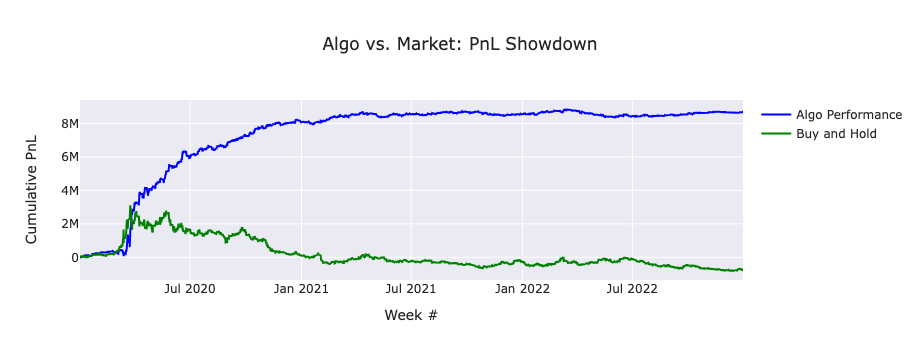

In [12]:
import plotly.graph_objects as go

# Create a Plotly figure
fig = go.Figure()

# Add a line trace for the different performances
fig.add_trace(go.Scatter(x=df['DateTime'], y=capital, mode='lines', name='Algo Performance',line=dict(color='blue')))
fig.add_trace(go.Scatter(x=df['DateTime'], y=(df['Close'][2:]-df['Close'][2])*100, mode='lines', name='Buy and Hold',line=dict(color='green')))

# Customize the layout
fig.update_layout(
    title='Algo vs. Market: PnL Showdown',
    xaxis_title='Week #',
    yaxis_title='Cumulative PnL',
    template='seaborn',  
)

# Display plot
fig.show()

# **Backtesting Analysis**

In [13]:
# PnL occurred in each trade
Trade_PnL = [round(trade.get('trade_pnl'),2) for trade in summary['trades']]

# The total PnL after each trade (starts from 0)
Total_PnL = summary['total_pnl']

# PnL for each trade: long and short positions
long_pnl = [round(trade.get('trade_pnl'),2) for trade in summary['trades'] if trade.get('type')=='long']
short_pnl = [round(trade.get('trade_pnl'),2) for trade in summary['trades'] if trade.get('type')=='short']

## **Trade Count and Win Rate**

In [14]:
trade_count = len(Trade_PnL)
winning_count = sum([1 for trade in Trade_PnL if trade>0])
losing_count = sum([1 for trade in Trade_PnL if trade<0])

win_rate = round(100*winning_count/trade_count,2)

In [15]:
print(f"Total Trades: {trade_count}\nWinning Trades: {winning_count}\nLosing Trades: {losing_count}\nTotal Win Rate: {win_rate} %")

Total Trades: 2122
Winning Trades: 973
Losing Trades: 1149
Total Win Rate: 45.85 %


## **Number of Long and Short Trades**

In [16]:
long_count = len(long_pnl)
short_count = len(short_pnl)

In [17]:
print(f"Long Trades: {long_count}\nShort Trades:{short_count}")

Long Trades: 1040
Short Trades:1082


## **Number of Winning and Losing Trades in Short and Long Trades**

In [18]:
long_winners = sum([1 for trade in long_pnl if trade>0])
long_losers = sum([1 for trade in long_pnl if trade<0])
long_winrate = round(100*long_winners/(long_winners+long_losers),2)

short_winners = sum([1 for trade in short_pnl if trade>=0])
short_losers= sum([1 for trade in short_pnl if trade<0])
short_winrate = round(100*short_winners/(short_winners+short_losers),2)

In [19]:
print(f"Number of Winning Long Trades: {long_winners}\nNumber of Losing Long Trades: {long_losers}\nWinning Rate of Long Trades: {long_winrate} %\n\nNumber of Winning Short Trades: {short_winners}\nNumber of Losing Short Trades: {short_losers}\nWinning Rate of Short Trades: {short_winrate} %")

Number of Winning Long Trades: 480
Number of Losing Long Trades: 560
Winning Rate of Long Trades: 46.15 %

Number of Winning Short Trades: 493
Number of Losing Short Trades: 589
Winning Rate of Short Trades: 45.56 %


## **Streak Counter for Trades**

In [20]:
def max_streak(numbers):
    # Initialize variables to track consecutive losses and gains
    max_consecutive_losses = 0
    max_consecutive_gains = 0
    current_consecutive_losses = 0
    current_consecutive_gains = 0    

    # Iterate through the list of numbers
    for num in numbers:
        # Check for consecutive losses
        if num < 0:
            current_consecutive_losses += 1
            current_consecutive_gains = 0
            max_consecutive_losses = max(max_consecutive_losses, current_consecutive_losses)
        # Check for consecutive gains
        elif num > 0:
            current_consecutive_losses = 0
            current_consecutive_gains += 1
            max_consecutive_gains = max(max_consecutive_gains, current_consecutive_gains)

    # Return the maximum consecutive losses and gains
    return max_consecutive_losses, max_consecutive_gains

# Calculate the maximum drawdown phase and value
streak = max_streak(Trade_PnL)


print(f"Maximum Consecutive Wins: {streak[1]} Trades\nMaximum Consecutive Losses: {streak[0]} Trades")

Maximum Consecutive Wins: 12 Trades
Maximum Consecutive Losses: 11 Trades


## **Largest Winning and Losing Trade**

In [21]:
max_gain = max(Trade_PnL)
max_loss = abs(min(Trade_PnL))

print(f"Largest Gain: {max_gain}\nLargest Loss: {max_loss}")

Largest Gain: 533190.38
Largest Loss: 309003.89


## **Maximum Drawdown Phase and Value**

In [22]:
def max_drawdown(numbers):
    # Initialize variables to track consecutive drawdown phases
    max_consecutive_drawdown = 0
    current_consecutive_drawdown = 0
    peak_value = 0
    max_drawdown_value = 0

    # Iterate through the list of numbers
    for num in numbers:
        # Check for drawdown phase and update the phase and value
        if num < peak_value:
            current_consecutive_drawdown += 1
            max_consecutive_drawdown = max(max_consecutive_drawdown, current_consecutive_drawdown)
            max_drawdown_value = max(max_drawdown_value, peak_value - num)
        else:
            peak_value = num
            current_consecutive_drawdown = 0

    # Return the maximum consecutive drawdown phase and its value
    return max_consecutive_drawdown, max_drawdown_value

# Calculate the maximum drawdown phase and value
drawdown = max_drawdown(Total_PnL)

print(f"Maximum Drawdown Phase: {drawdown[0]} Trades\nMaximum Drawdown:{round(drawdown[1],2)}")

Maximum Drawdown Phase: 989 Trades
Maximum Drawdown:486110.27


## **PnL Calculation and Profit Factor**

In [23]:
net_pnl = round(sum(Trade_PnL),2)
gross_profit =  round(sum(num for num in Trade_PnL if num > 0),2)
gross_loss = round(abs(sum(num for num in Trade_PnL if num < 0)),2)

try:
    profit_factor = round(gross_profit/gross_loss,2)
    print(f"Net PnL: {net_pnl}\nGross Profit: {gross_profit}\nGross Loss: {gross_loss}\nProfit Factor: {profit_factor}")
except ZeroDivisionError:
    profit_factor = 'Infinity'
    print(f"Net PnL: {net_pnl}\nGross Profit: {gross_profit}\nGross Loss: {gross_loss}\nProfit Factor: {profit_factor}")

Net PnL: 8693804.32
Gross Profit: 25441069.21
Gross Loss: 16747264.89
Profit Factor: 1.52


## **PnL of Short and Long Trades**

In [24]:
long_net_pnl = round(sum(long_pnl),2)
long_winners_pnl = round(sum([trade for trade in long_pnl if trade>0]),2)
long_losers_pnl = round(sum([trade for trade in long_pnl if trade<0]),2)

short_net_pnl = round(sum(short_pnl),2)
short_winners_pnl = round(sum([trade for trade in short_pnl if trade>0]),2)
short_losers_pnl= round(sum([trade for trade in short_pnl if trade<0]),2)

In [25]:
print(f"Net PnL of Long Trades: {long_net_pnl}\nGross Profit of Long Trades: {long_winners_pnl}\nGross Loss of Long Trades: {abs(long_losers_pnl)}\n\nNet PnL of Short Trades: {short_net_pnl}\nGross Profit of Short Trades: {short_winners_pnl}\nGross Loss of Short Trades: {abs(short_losers_pnl)}")

Net PnL of Long Trades: 4769678.62
Gross Profit of Long Trades: 12740217.36
Gross Loss of Long Trades: 7970538.74

Net PnL of Short Trades: 3924125.7
Gross Profit of Short Trades: 12700851.85
Gross Loss of Short Trades: 8776726.15


## **Average Profit/Trade**

In [26]:
pnl_per_trade = round(net_pnl/trade_count,2)
print(f"Average Profit per Trade: {pnl_per_trade}")

Average Profit per Trade: 4096.99


# **Conclusion**

In conclusion, this 3 minute trading strategy exhibits a robust performance with positive net profit, low drawdown, commendable win rates, and a favorable profit factor. This Algo also demonstrated exceptional outperformance, surpassing traditional Buy and Hold strategy by almost 1 Cr. Although the current strategy carries a slight inherent risk compared to the previous ML-based strategy, it stands out as a more potent profit generator.

# **Appendix**
## **Appendix A**
### Complete List of Trades
Here is the complete list of trades taken by our algo in a span of almost 3 years. Execute the provided code to generate a CSV file containing all the trades executed by our strategy for the given dataset.

In [27]:
trades = summary['trades']

trade_df = pd.DataFrame(trades)

# Mapping 'type' to 'qty'
trade_df['qty'] = trade_df['type'].apply(lambda x: 100 if x == 'long' else -100)

# Formatting date and time columns
trade_df['entry_date'] = pd.to_datetime(trade_df['entry_time']).dt.strftime('%Y%m%d')
trade_df['exit_date'] = pd.to_datetime(trade_df['exit_time']).dt.strftime('%Y%m%d')
trade_df['entry_time'] = pd.to_datetime(trade_df['entry_time']).dt.strftime('%H%M')
trade_df['exit_time'] = pd.to_datetime(trade_df['exit_time']).dt.strftime('%H%M')

# Renaming columns to match the required format
trade_df = trade_df.rename(columns={'entry_date': 'entrydate', 'entry_time': 'entrytime', 'exit_date': 'exitdate', 'exit_time': 'exittime', 'entry_price': 'entryprice', 'exit_price': 'exitprice'})

# Keeping only the required columns
trade_df = trade_df[['qty', 'entrydate', 'entrytime', 'entryprice', 'exitdate', 'exittime', 'exitprice']]

# Save the DataFrame to a CSV file
trade_df.to_csv('SiddAdi_Markov_trades_3minTF.csv', index=False)

print("Trades saved to 'SiddAdi_Markov_trades_3minTF.csv'")

Trades saved to 'SiddAdi_Markov_trades_3minTF.csv'


## **Appendix B**
### Day-wise Equity and Drawdown Curve

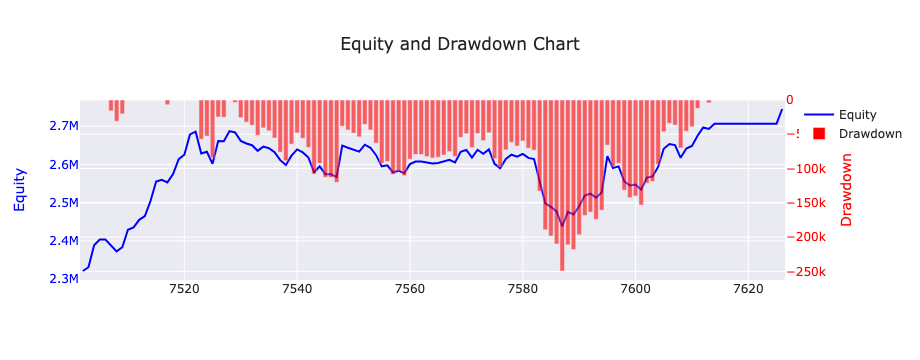

In [28]:
import plotly.graph_objects as go
import numpy as np

equity_values = capital  
drawdown_values = np.maximum.accumulate(equity_values) - equity_values

n = 60 # Get the curve for the nth trading day

# Create traces for equity and drawdown
trace_equity = go.Scatter(x=df[n*125:125*(n+1)].index, y=equity_values[n*125:125*(n+1)], name='Equity', line=dict(color='blue'))
trace_drawdown = go.Bar(x=df[n*125:125*(n+1)].index, y=-drawdown_values[n*125:125*(n+1)], name='Drawdown', marker=dict(color='red',opacity = 0.6), yaxis='y2')

# Create layout with secondary y-axis
layout = go.Layout(
    title='Equity and Drawdown Chart',
    yaxis=dict(title='Equity', color='blue'),
    yaxis2=dict(title='Drawdown', overlaying='y', side='right', color='red'),
    template = 'seaborn'
)

# Create figure
fig = go.Figure(data=[trace_equity, trace_drawdown], layout=layout)

# Show the figure
fig.show()